In [1]:
# Copyright (c) Meta Platforms, Inc. and affiliates.

# Depth Estimation <a target="_blank" href="https://colab.research.google.com/github/facebookresearch/dinov2/blob/main/notebooks/depth_estimation.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
# Install requirements first using our index urls
%pip install -r "../requirements.txt" -r "../requirements-extras.txt"
# Install this as a python module
%pip install -e ..[extras]

Looking in indexes: https://download.pytorch.org/whl/cu124, https://pypi.nvidia.com, https://pypi.org/simple
Note: you may need to restart the kernel to use updated packages.
Obtaining file:///home/ammonium/src/dinov2
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for dinov2 (pyproject.toml) ... done
  Created wheel for dinov2: filename=dinov2-0.1.0-0.editable-py3-none-any.whl size=11986 sha256=c8354a6a4dce961a9374b0d09631960f34f709b70823d424a98a439e9c4eb84e
  Stored in directory: /tmp/pip-ephem-wheel-cache-x59krlbk/wheels/45/f3/4b/d489414609d7c3773952de31a1075be21d56a2a63c03372390
Successfully built dinov2
  Attempting uninstall: dinov2
    Found existing installation: dinov2 0.1.0
    Uninstalling dinov2-0.1.0:
      Successfully uninstalled dinov2-0.1.0
Note: you may need to restart the kernel to use upda

## Utilities

In [3]:
import math
import itertools
from functools import partial

import torch
import torch.nn.functional as F

from dinov2.eval.depth.models import build_depther


class CenterPadding(torch.nn.Module):
    def __init__(self, multiple):
        super().__init__()
        self.multiple = multiple

    def _get_pad(self, size):
        new_size = math.ceil(size / self.multiple) * self.multiple
        pad_size = new_size - size
        pad_size_left = pad_size // 2
        pad_size_right = pad_size - pad_size_left
        return pad_size_left, pad_size_right

    @torch.inference_mode()
    def forward(self, x):
        pads = list(itertools.chain.from_iterable(self._get_pad(m) for m in x.shape[:1:-1]))
        output = F.pad(x, pads)
        return output


def create_depther(cfg, backbone_model, backbone_size, head_type):
    train_cfg = cfg.get("train_cfg")
    test_cfg = cfg.get("test_cfg")
    depther = build_depther(cfg.model, train_cfg=train_cfg, test_cfg=test_cfg)

    depther.backbone.forward = partial(
        backbone_model.get_intermediate_layers,
        n=cfg.model.backbone.out_indices,
        reshape=True,
        return_class_token=cfg.model.backbone.output_cls_token,
        norm=cfg.model.backbone.final_norm,
    )

    if hasattr(backbone_model, "patch_size"):
        depther.backbone.register_forward_pre_hook(lambda _, x: CenterPadding(backbone_model.patch_size)(x[0]))

    return depther

## Load pretrained backbone

In [4]:
BACKBONE_SIZE = "small" # in ("small", "base", "large" or "giant")


backbone_archs = {
    "small": "vits14",
    "base": "vitb14",
    "large": "vitl14",
    "giant": "vitg14",
}
backbone_arch = backbone_archs[BACKBONE_SIZE]
backbone_name = f"dinov2_{backbone_arch}"

backbone_model = torch.hub.load(repo_or_dir="facebookresearch/dinov2", model=backbone_name)
backbone_model.eval()
backbone_model.cuda()

Using cache found in /home/ammonium/.cache/torch/hub/facebookresearch_dinov2_main
/home/ammonium/src/dinov2/dinov2/layers/swiglu_ffn.py:43: UserWarning: xFormers is available (SwiGLU)
  warnings.warn("xFormers is available (SwiGLU)")
/home/ammonium/src/dinov2/dinov2/layers/attention.py:27: UserWarning: xFormers is available (Attention)
  warnings.warn("xFormers is available (Attention)")
/home/ammonium/src/dinov2/dinov2/layers/block.py:33: UserWarning: xFormers is available (Block)
  warnings.warn("xFormers is available (Block)")


DinoVisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 384, kernel_size=(14, 14), stride=(14, 14))
    (norm): Identity()
  )
  (blocks): ModuleList(
    (0-11): 12 x NestedTensorBlock(
      (norm1): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
      (attn): MemEffAttention(
        (qkv): Linear(in_features=384, out_features=1152, bias=True)
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=384, out_features=384, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): LayerScale()
      (drop_path1): Identity()
      (norm2): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=384, out_features=1536, bias=True)
        (act): GELU(approximate='none')
        (fc2): Linear(in_features=1536, out_features=384, bias=True)
        (drop): Dropout(p=0.0, inplace=False)
      )
      (ls2): LayerScale()
      (drop_path2): Identity()
    )
  )
  (n

## Load pretrained depth head

In [5]:
import urllib

import mmcv
from mmcv.runner import load_checkpoint


def load_config_from_url(url: str) -> str:
    with urllib.request.urlopen(url) as f:
        return f.read().decode()


HEAD_DATASET = "nyu" # in ("nyu", "kitti")
HEAD_TYPE = "dpt" # in ("linear", "linear4", "dpt")


DINOV2_BASE_URL = "https://dl.fbaipublicfiles.com/dinov2"
head_config_url = f"{DINOV2_BASE_URL}/{backbone_name}/{backbone_name}_{HEAD_DATASET}_{HEAD_TYPE}_config.py"
head_checkpoint_url = f"{DINOV2_BASE_URL}/{backbone_name}/{backbone_name}_{HEAD_DATASET}_{HEAD_TYPE}_head.pth"

cfg_str = load_config_from_url(head_config_url)
cfg = mmcv.Config.fromstring(cfg_str, file_format=".py")

model = create_depther(
    cfg,
    backbone_model=backbone_model,
    backbone_size=BACKBONE_SIZE,
    head_type=HEAD_TYPE,
)

load_checkpoint(model, head_checkpoint_url, map_location="cpu")
model.eval()
model.cuda()

load checkpoint from http path: https://dl.fbaipublicfiles.com/dinov2/dinov2_vits14/dinov2_vits14_nyu_dpt_head.pth


DepthEncoderDecoder(
  (backbone): DinoVisionTransformer()
  (decode_head): DPTHead(
    align_corners=False
    (loss_decode): ModuleList(
      (0): SigLoss()
      (1): GradientLoss()
    )
    (conv_depth): HeadDepth(
      (head): Sequential(
        (0): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): Interpolate()
        (2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU()
        (4): Conv2d(32, 1, kernel_size=(1, 1), stride=(1, 1))
      )
    )
    (relu): ReLU()
    (sigmoid): Sigmoid()
    (reassemble_blocks): ReassembleBlocks(
      (projects): ModuleList(
        (0): ConvModule(
          (conv): Conv2d(384, 48, kernel_size=(1, 1), stride=(1, 1))
        )
        (1): ConvModule(
          (conv): Conv2d(384, 96, kernel_size=(1, 1), stride=(1, 1))
        )
        (2): ConvModule(
          (conv): Conv2d(384, 192, kernel_size=(1, 1), stride=(1, 1))
        )
        (3): ConvModule(
          (co

## Load sample image

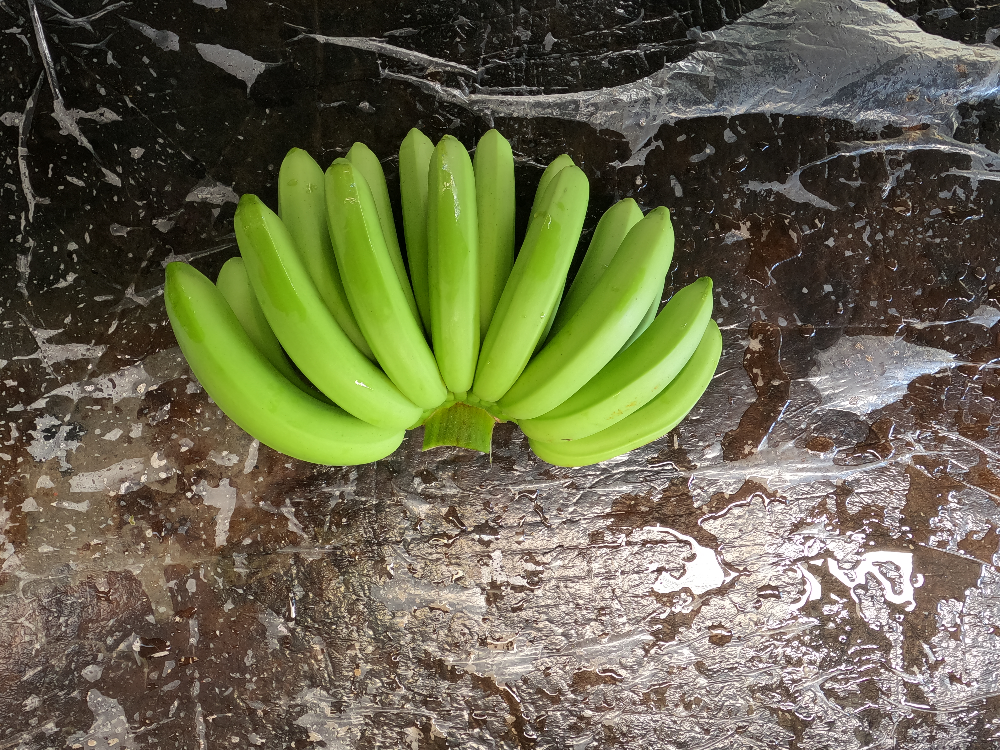

In [6]:
from pathlib import Path
from PIL import Image

def load_image(path: Path|str) -> Image:
    if isinstance(path, str):
        path = Path(path)
    return Image.open(path).convert("RGB")

image = load_image('../Images/1000000335.jpeg')

display(image)

## Estimate depth on sample image

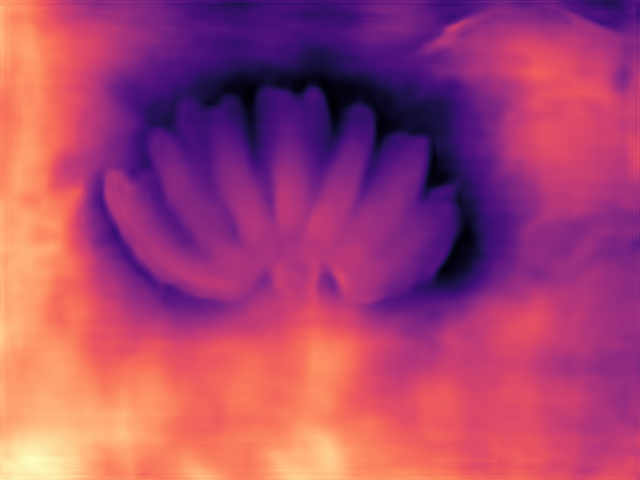

In [7]:
import matplotlib
from torchvision import transforms


def make_depth_transform() -> transforms.Compose:
    return transforms.Compose([
        transforms.ToTensor(),
        lambda x: 255.0 * x[:3], # Discard alpha component and scale by 255
        transforms.Normalize(
            mean=(123.675, 116.28, 103.53),
            std=(58.395, 57.12, 57.375),
        ),
    ])


def render_depth(values, colormap_name="magma_r") -> Image:
    min_value, max_value = values.min(), values.max()
    normalized_values = (values - min_value) / (max_value - min_value)

    colormap = matplotlib.colormaps[colormap_name]
    colors = colormap(normalized_values, bytes=True) # ((1)xhxwx4)
    colors = colors[:, :, :3] # Discard alpha component
    return Image.fromarray(colors)


transform = make_depth_transform()

IMAGE_SZ = (640, 480)

def estimate_depth(image: Image, transform: transforms.Compose, image_sz: tuple[int]) -> Image:
    rescaled_image = image.resize(image_sz)
    transformed_image = transform(rescaled_image)
    batch = transformed_image.unsqueeze(0).cuda() # Make a batch of one image

    with torch.inference_mode():
        result = model.whole_inference(batch, img_meta=None, rescale=True)
    
    depth_image = render_depth(result.squeeze().cpu())
    return depth_image


depth_image = estimate_depth(image, transform, IMAGE_SZ)
display(depth_image)

# Batch depth estimation

In [8]:
def save_image(image: Image, path: Path|str) -> None:
    if isinstance(path, str):
        path = Path(path)
    image.save(path)

In [9]:
import os

source_dir = '../Images'
output_dir = '../DepthImages'
image_extensions = ('.png', '.jpg', '.jpeg')

for filename in os.listdir(source_dir):
    if filename.endswith(image_extensions):
        print(f"Processing {filename}")
        image = load_image(os.path.join(source_dir, filename))
        depth_image = estimate_depth(image, transform, IMAGE_SZ)
        save_image(depth_image, os.path.join(output_dir, filename))
        print(f"Saved {filename}")

Processing 1000000546.jpeg
Saved 1000000546.jpeg
Processing 1000000471.jpeg
Saved 1000000471.jpeg
Processing 1000000551.jpeg
Saved 1000000551.jpeg
Processing 1000000351.jpeg
Saved 1000000351.jpeg
Processing 1000000517.jpeg
Saved 1000000517.jpeg
Processing 1000000338.jpeg
Saved 1000000338.jpeg
Processing 1000000550.jpeg
Saved 1000000550.jpeg
Processing 1000000572.jpeg
Saved 1000000572.jpeg
Processing 1000000585.jpeg
Saved 1000000585.jpeg
Processing 1000000649.jpeg
Saved 1000000649.jpeg
Processing DEMO_02-1.jpeg
Saved DEMO_02-1.jpeg
Processing 1000000586.jpeg
Saved 1000000586.jpeg
Processing 1000000565.jpeg
Saved 1000000565.jpeg
Processing 1000000584.jpeg
Saved 1000000584.jpeg
Processing 1000000554.jpeg
Saved 1000000554.jpeg
Processing 1000000457.jpeg
Saved 1000000457.jpeg
Processing 1000000335.jpeg
Saved 1000000335.jpeg
Processing 1000000644.jpeg
Saved 1000000644.jpeg
Processing 1000000561.jpeg
Saved 1000000561.jpeg
Processing 1000000675.jpeg
Saved 1000000675.jpeg
Processing 1000000341.